Reference& edited from : https://nanonets.com/blog/optical-flow/


In [1]:
!gdown --id 1Y1gXlI5EfEktzgdlpJd-_YrqJV7WRRGn

Downloading...
From: https://drive.google.com/uc?id=1Y1gXlI5EfEktzgdlpJd-_YrqJV7WRRGn
To: /content/single-object-tracking-using-optical-flow.gif
5.43MB [00:00, 25.5MB/s]


In [2]:
import cv2 as cv
import numpy as np

In [3]:
cap = cv.VideoCapture("/content/single-object-tracking-using-optical-flow.gif")

In [4]:
ret, first_frame = cap.read()

In [5]:
first_frame.shape

(338, 600, 3)

In [6]:
mask = np.zeros_like(first_frame)
mask[..., 1] = 255

In [7]:
prev_gray = cv.cvtColor(first_frame, cv.COLOR_BGR2GRAY)

In [8]:
from google.colab.patches import cv2_imshow

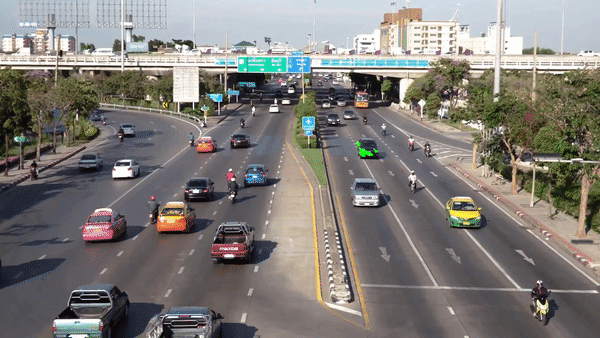

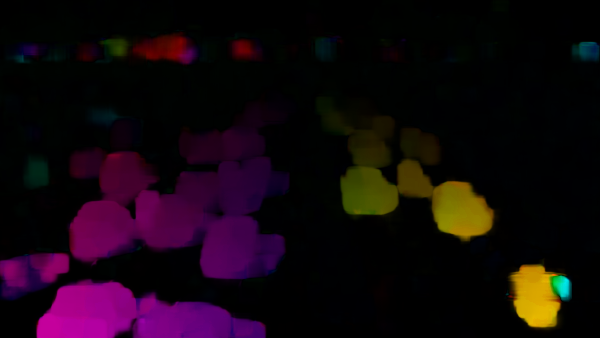

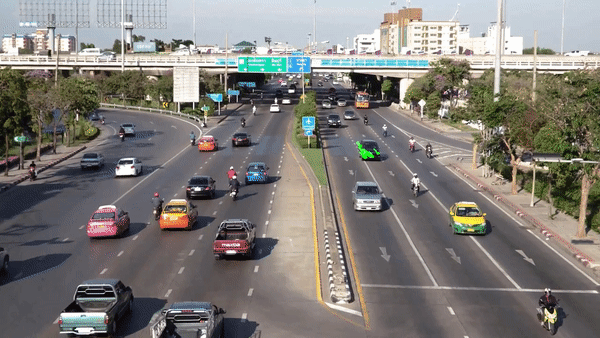

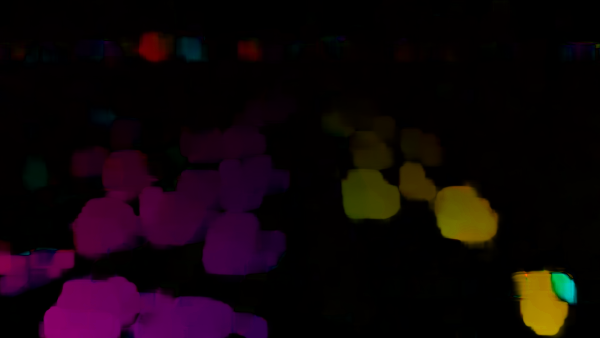

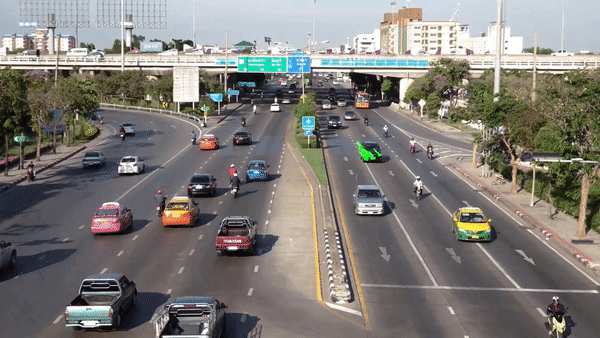

...

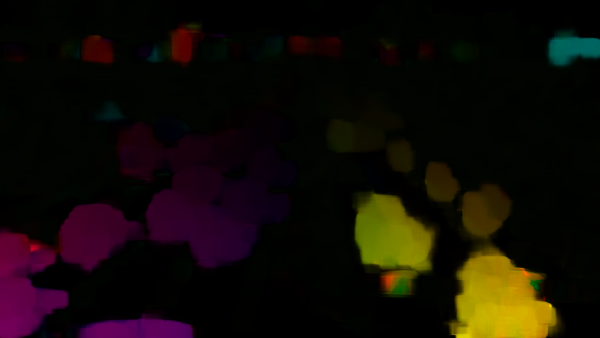

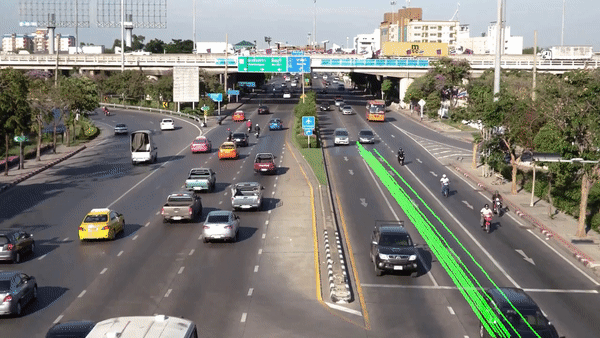

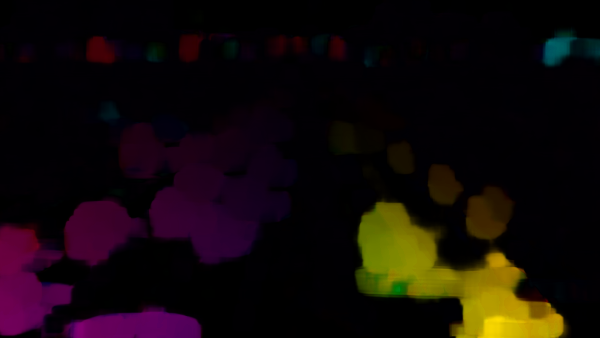

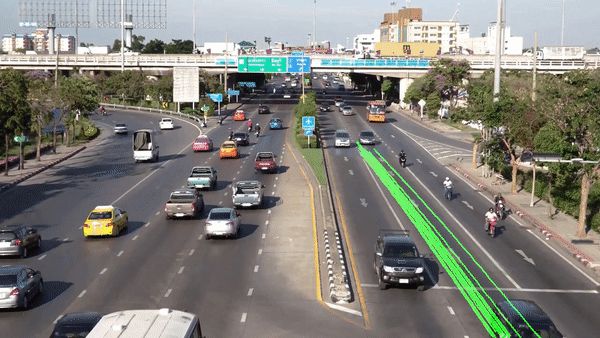

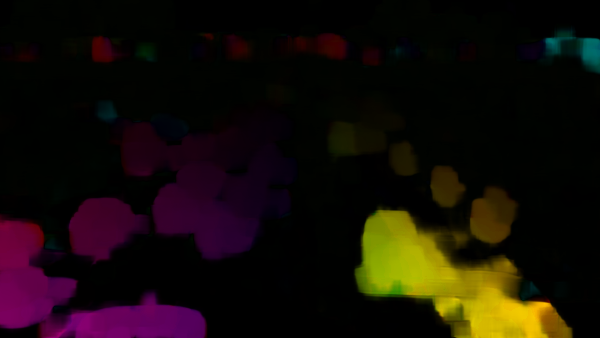

In [9]:
while(cap.isOpened()):
    # ret = a boolean return value from getting the frame, frame = the current frame being projected in the video
    ret, frame = cap.read()
    # Opens a new window and displays the input frame
    if frame is None:
      break
    cv2_imshow(frame)
    # Converts each frame to grayscale - we previously only converted the first frame to grayscale
    gray = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
    # Calculates dense optical flow by Farneback method
    flow = cv.calcOpticalFlowFarneback(prev_gray, gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)
    # Computes the magnitude and angle of the 2D vectors
    magnitude, angle = cv.cartToPolar(flow[..., 0], flow[..., 1])
    # Sets image hue according to the optical flow direction
    mask[..., 0] = angle * 180 / np.pi / 2
    # Sets image value according to the optical flow magnitude (normalized)
    mask[..., 2] = cv.normalize(magnitude, None, 0, 255, cv.NORM_MINMAX)
    # Converts HSV to RGB (BGR) color representation
    rgb = cv.cvtColor(mask, cv.COLOR_HSV2BGR)
    # Opens a new window and displays the output frame
    cv2_imshow(
        rgb)
    # Updates previous frame
    prev_gray = gray
    # Frames are read by intervals of 1 millisecond. The programs breaks out of the while loop when the user presses the 'q' key
    if cv.waitKey(1) & 0xFF == ord('q'):
        break
# The following frees up resources and closes all windows
cap.release()
cv.destroyAllWindows()